In [1]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

# Input data files are available in the read-only "../input/" directory
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

import os
for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        print(os.path.join(dirname, filename))

# You can write up to 20GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All" 
# You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session

/kaggle/input/2000-16-traffic-flow-england-scotland-wales/accidents_2012_to_2014.csv
/kaggle/input/2000-16-traffic-flow-england-scotland-wales/accidents_2009_to_2011.csv
/kaggle/input/2000-16-traffic-flow-england-scotland-wales/accidents_2005_to_2007.csv
/kaggle/input/2000-16-traffic-flow-england-scotland-wales/accident_coords_update.ipynb
/kaggle/input/2000-16-traffic-flow-england-scotland-wales/ukTrafficAADF.csv
/kaggle/input/2000-16-traffic-flow-england-scotland-wales/Areas.shp
/kaggle/input/2000-16-traffic-flow-england-scotland-wales/Local_Authority_Districts_Dec_2016.geojson


In [2]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

import folium
from folium.plugins import HeatMap
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import classification_report, confusion_matrix

# Tarih-saat işlemleri için
from datetime import datetime

# Grafikler için görselleştirme ayarları
sns.set_style('whitegrid')

In [3]:
# 1. CSV dosyalarını oku
df_0507 = pd.read_csv('/kaggle/input/2000-16-traffic-flow-england-scotland-wales/accidents_2005_to_2007.csv')
df_0911 = pd.read_csv('/kaggle/input/2000-16-traffic-flow-england-scotland-wales/accidents_2009_to_2011.csv')
df_1214 = pd.read_csv('/kaggle/input/2000-16-traffic-flow-england-scotland-wales/accidents_2012_to_2014.csv')

/tmp/ipykernel_35/991530700.py:2: DtypeWarning: Columns (31) have mixed types. Specify dtype option on import or set low_memory=False.
  df_0507 = pd.read_csv('/kaggle/input/2000-16-traffic-flow-england-scotland-wales/accidents_2005_to_2007.csv')
/tmp/ipykernel_35/991530700.py:4: DtypeWarning: Columns (31) have mixed types. Specify dtype option on import or set low_memory=False.
  df_1214 = pd.read_csv('/kaggle/input/2000-16-traffic-flow-england-scotland-wales/accidents_2012_to_2014.csv')


In [4]:
# 2. Hepsini tek bir DataFrame'de birleştir
df = pd.concat([df_0507, df_0911, df_1214], ignore_index=True)

In [5]:
# 3. 'Date' sütununu datetime formatına çevir
df['Date'] = pd.to_datetime(df['Date'], errors='coerce')

In [6]:
# 4. 'Year' sütunu ekle
df['Year'] = df['Date'].dt.year.astype('Int64')

In [7]:
df.head()

,Accident_Index,Location_Easting_OSGR,Location_Northing_OSGR,Longitude,Latitude,Police_Force,Accident_Severity,Number_of_Vehicles,Number_of_Casualties,Date,...,Pedestrian_Crossing-Physical_Facilities,Light_Conditions,Weather_Conditions,Road_Surface_Conditions,Special_Conditions_at_Site,Carriageway_Hazards,Urban_or_Rural_Area,Did_Police_Officer_Attend_Scene_of_Accident,LSOA_of_Accident_Location,Year
0,200501BS00001,525680.0,178240.0,-0.191170,51.489096,1,2,1,1,2005-04-01,...,Zebra crossing,Daylight: Street light present,Raining without high winds,Wet/Damp,NaN,NaN,1,Yes,E01002849,2005
1,200501BS00002,524170.0,181650.0,-0.211708,51.520075,1,3,1,1,2005-05-01,...,Pedestrian phase at traffic signal junction,Darkness: Street lights present and lit,Fine without high winds,Dry,NaN,NaN,1,Yes,E01002909,2005
2,200501BS00003,524520.0,182240.0,-0.206458,51.525301,1,3,2,1,2005-06-01,...,No physical crossing within 50 meters,Darkness: Street lights present and lit,Fine without high winds,Dry,NaN,NaN,1,Yes,E01002857,2005
3,200501BS00004,526900.0,177530.0,-0.173862,51.482442,1,3,1,1,2005-07-01,...,No physical crossing within 50 meters,Daylight: Street light present,Fine without high winds,Dry,NaN,NaN,1,Yes,E01002840,2005
4,200501BS00005,528060.0,179040.0,-0.156618,51.495752,1,3,1,1,2005-10-01,...,No physical crossing within 50 meters,Darkness: Street lighting unknown,Fine without high winds,Wet/Damp,NaN,NaN,1,Yes,E01002863,2005


In [8]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1504150 entries, 0 to 1504149
Data columns (total 33 columns):
 #   Column                                       Non-Null Count    Dtype         
---  ------                                       --------------    -----         
 0   Accident_Index                               1504150 non-null  object        
 1   Location_Easting_OSGR                        1504049 non-null  float64       
 2   Location_Northing_OSGR                       1504049 non-null  float64       
 3   Longitude                                    1504049 non-null  float64       
 4   Latitude                                     1504049 non-null  float64       
 5   Police_Force                                 1504150 non-null  int64         
 6   Accident_Severity                            1504150 non-null  int64         
 7   Number_of_Vehicles                           1504150 non-null  int64         
 8   Number_of_Casualties                         1504150

In [9]:
# Eksik değer sayıları
print(df.isnull().sum())

Accident_Index                                       0
Location_Easting_OSGR                              101
Location_Northing_OSGR                             101
Longitude                                          101
Latitude                                           101
Police_Force                                         0
Accident_Severity                                    0
Number_of_Vehicles                                   0
Number_of_Casualties                                 0
Date                                            905588
Day_of_Week                                          0
Time                                               117
Local_Authority_(District)                           0
Local_Authority_(Highway)                            0
1st_Road_Class                                       0
1st_Road_Number                                      0
Road_Type                                            0
Speed_limit                                          0
Junction_D

In [10]:
# 'Time' sütunundaki boşlukları doldurma ve uygun formata çevirme
df['Time'] = df['Time'].fillna('00:00')  # Eksik zamanı 00:00 yaptık
df['Time'] = pd.to_datetime(df['Time'], format='%H:%M', errors='coerce').dt.time

# Gün ve Saat sütunlarını ayrı ayrı çıkaralım (zaten 'Date' var)
df['Hour'] = pd.to_datetime(df['Time'], format='%H:%M:%S').dt.hour

# Örnek kontrol
df[['Date', 'Time', 'Hour']].head()

,Date,Time,Hour
0,2005-04-01,17:42:00,17
1,2005-05-01,17:36:00,17
2,2005-06-01,00:15:00,0
3,2005-07-01,10:35:00,10
4,2005-10-01,21:13:00,21


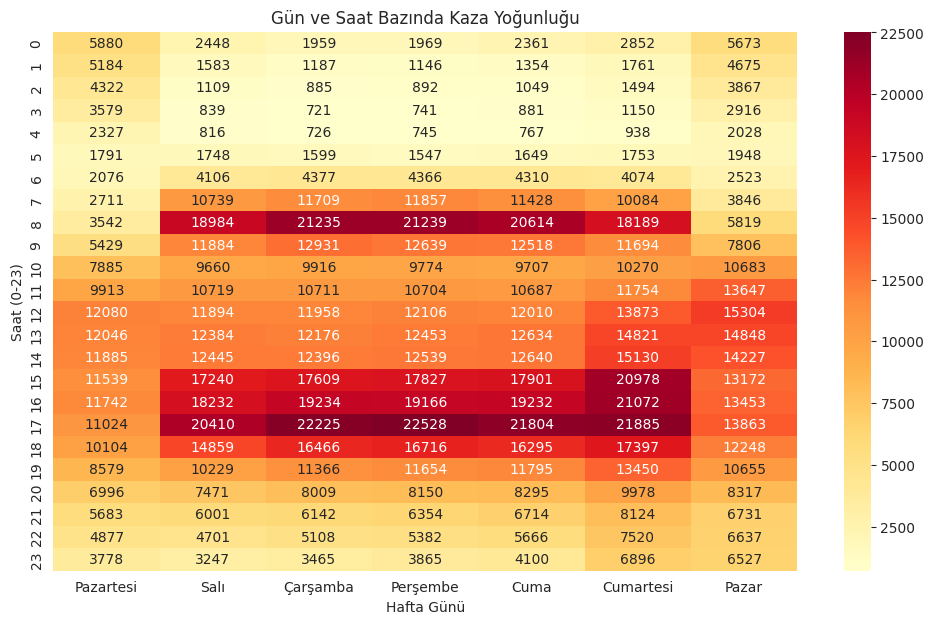

In [11]:
# Gün ve saat bazında kaza sayısı pivot tablosu
heatmap_data = df.pivot_table(index='Hour', columns='Day_of_Week', values='Accident_Index', aggfunc='count')

# Gün isimlerini ekleyelim (isteğe göre)
days = {1:'Pazartesi', 2:'Salı', 3:'Çarşamba', 4:'Perşembe', 5:'Cuma', 6:'Cumartesi', 7:'Pazar'}
heatmap_data.columns = [days.get(x, x) for x in heatmap_data.columns]

plt.figure(figsize=(12,7))
sns.heatmap(heatmap_data, cmap='YlOrRd', annot=True, fmt='.0f')
plt.title('Gün ve Saat Bazında Kaza Yoğunluğu')
plt.ylabel('Saat (0-23)')
plt.xlabel('Hafta Günü')
plt.show()

In [12]:
yearly_counts = df.groupby('Year').size()
print(yearly_counts)

Year
2005    77780
2006    76138
2007    71867
2009    66172
2010    60742
2011    61438
2012    69533
2013    55823
2014    59069
dtype: int64


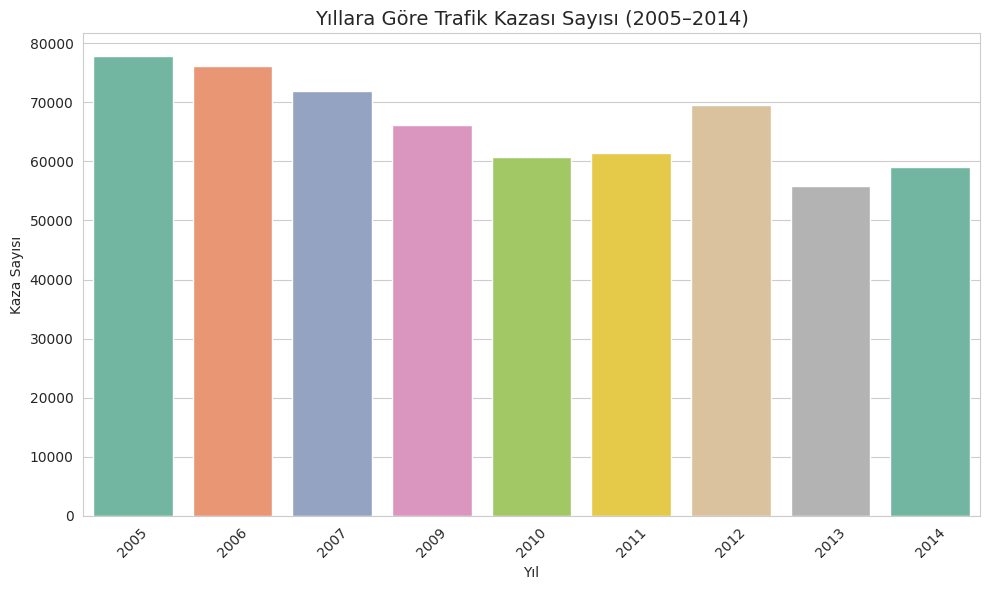

In [13]:
# 5. Yıllık kaza sayısını görselleştir
yearly_accidents = df['Year'].value_counts().sort_index()

plt.figure(figsize=(10,6))
sns.barplot(x=yearly_accidents.index, y=yearly_accidents.values, palette='Set2')
plt.title('Yıllara Göre Trafik Kazası Sayısı (2005–2014)', fontsize=14)
plt.xlabel('Yıl')
plt.ylabel('Kaza Sayısı')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

In [14]:
# Geçerli koordinatları al (boş olmayan)
location_df = df[['Latitude', 'Longitude']].dropna()

# Harita merkezi
map_center = [location_df['Latitude'].mean(), location_df['Longitude'].mean()]
m = folium.Map(location=map_center, zoom_start=6)

# Isı haritası
HeatMap(location_df.values.tolist(), radius=6).add_to(m)
m

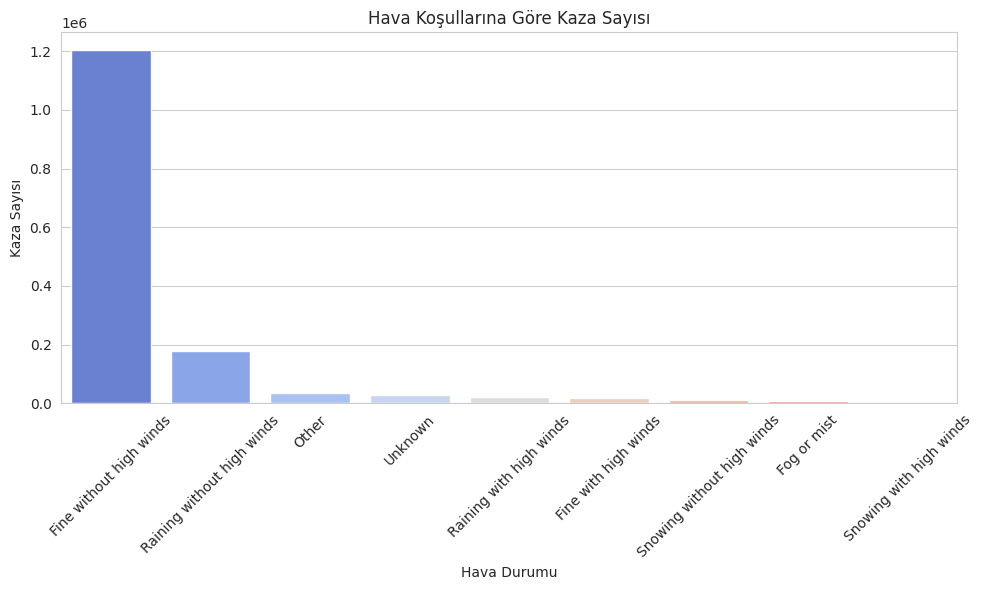

In [15]:
plt.figure(figsize=(10,6))
sns.countplot(data=df, x='Weather_Conditions', order=df['Weather_Conditions'].value_counts().index, palette='coolwarm')
plt.title('Hava Koşullarına Göre Kaza Sayısı')
plt.ylabel('Kaza Sayısı')
plt.xlabel('Hava Durumu')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

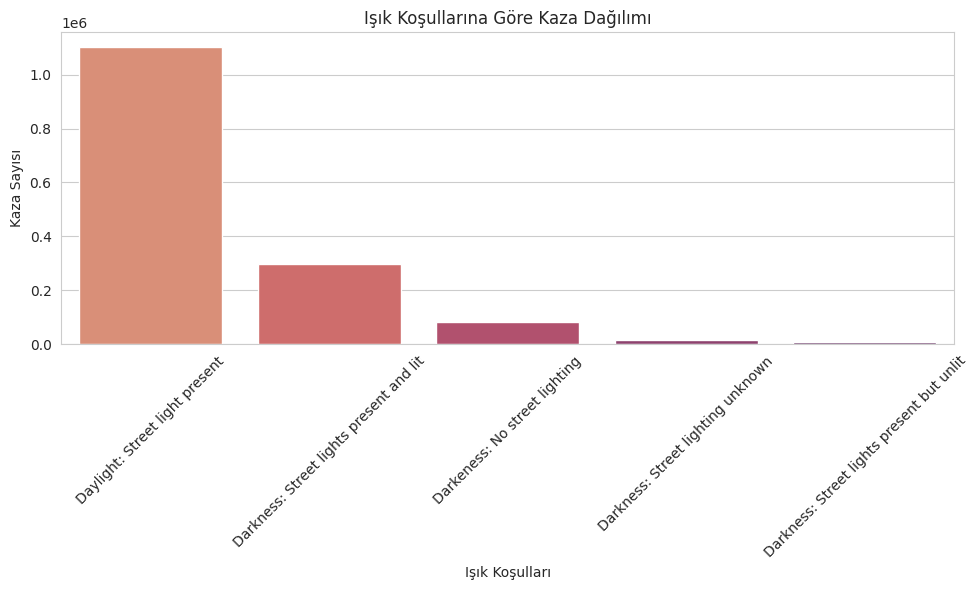

In [16]:
plt.figure(figsize=(10,6))
sns.countplot(data=df, x='Light_Conditions', order=df['Light_Conditions'].value_counts().index, palette='flare')
plt.title('Işık Koşullarına Göre Kaza Dağılımı')
plt.ylabel('Kaza Sayısı')
plt.xlabel('Işık Koşulları')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

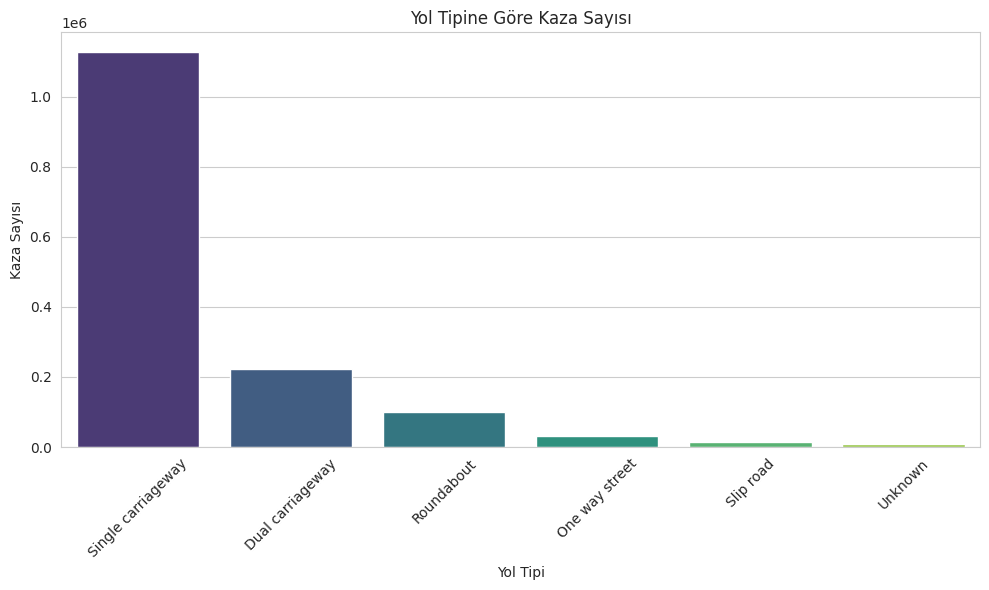

In [17]:
plt.figure(figsize=(10,6))
sns.countplot(data=df, x='Road_Type', order=df['Road_Type'].value_counts().index, palette='viridis')
plt.title('Yol Tipine Göre Kaza Sayısı')
plt.ylabel('Kaza Sayısı')
plt.xlabel('Yol Tipi')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

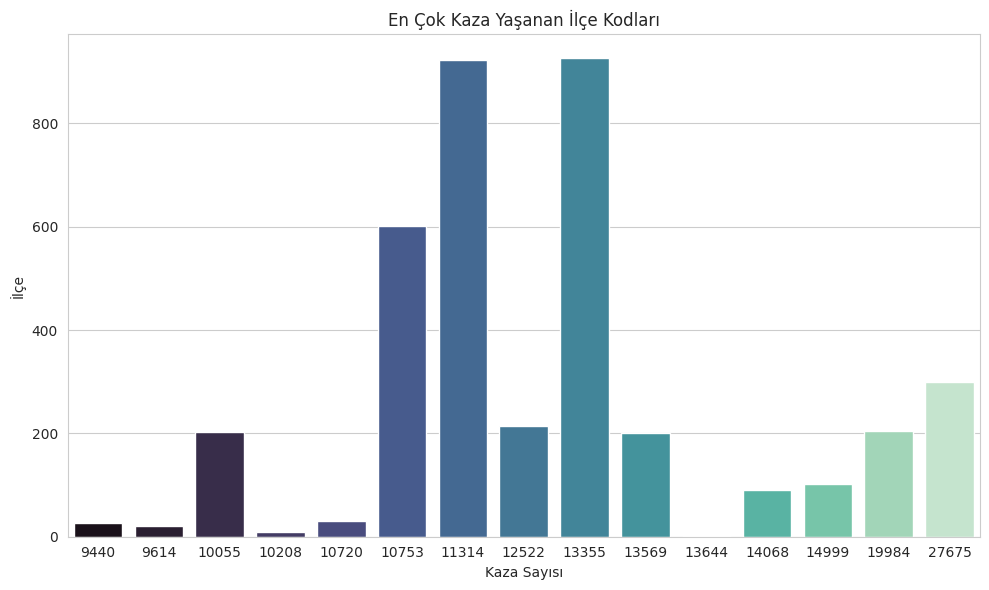

In [18]:
plt.figure(figsize=(10,6))
top_districts = df['Local_Authority_(District)'].value_counts().head(15)
sns.barplot(x=top_districts.values, y=top_districts.index, palette='mako')
plt.title('En Çok Kaza Yaşanan İlçe Kodları')
plt.xlabel('Kaza Sayısı')
plt.ylabel('İlçe')
plt.tight_layout()
plt.show()

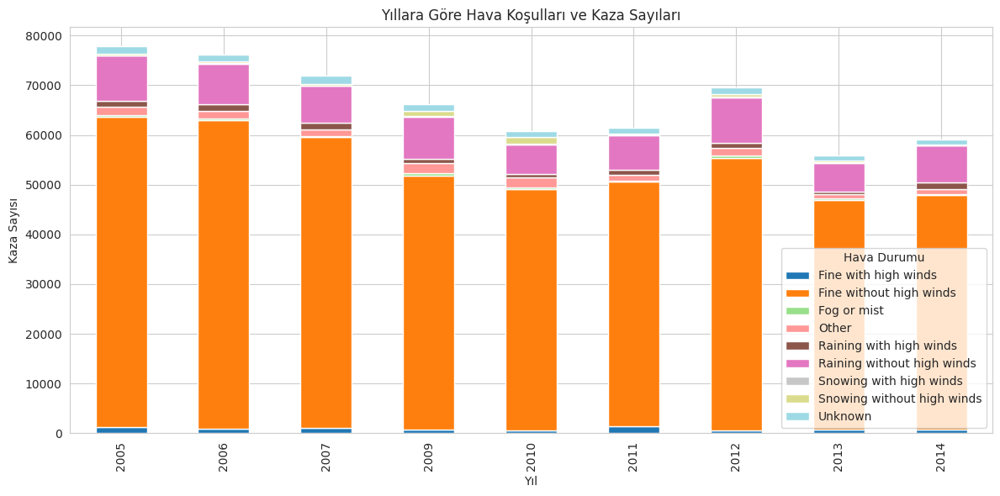

In [19]:
df_grouped = df.groupby(['Year', 'Weather_Conditions']).size().unstack().fillna(0)
df_grouped.plot(kind='bar', stacked=True, figsize=(12,6), colormap='tab20')
plt.title('Yıllara Göre Hava Koşulları ve Kaza Sayıları')
plt.xlabel('Yıl')
plt.ylabel('Kaza Sayısı')
plt.legend(title='Hava Durumu')
plt.tight_layout()
plt.show()

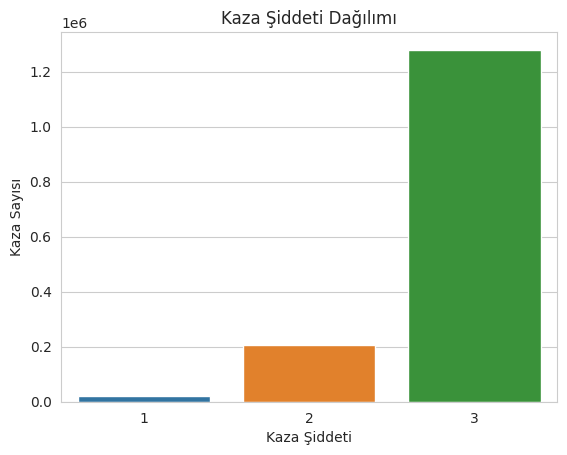

In [20]:
# Kaza şiddeti dağılımı
sns.countplot(x='Accident_Severity', data=df)
plt.title('Kaza Şiddeti Dağılımı')
plt.xlabel('Kaza Şiddeti')
plt.ylabel('Kaza Sayısı')
plt.show()

# 6.1. Basit Veri Hazırlığı

In [21]:
# İlgili sütunları seçelim
model_df = df[['Accident_Severity', 'Road_Type', 'Weather_Conditions', 'Speed_limit', 'Hour', 'Number_of_Vehicles']].copy()

# Eksik veri varsa silelim (ya da uygun yöntemle doldurabiliriz)
model_df = model_df.dropna()

# Kategorik sütunları etiketleyelim
le_road = LabelEncoder()
model_df['Road_Type_enc'] = le_road.fit_transform(model_df['Road_Type'])

le_weather = LabelEncoder()
model_df['Weather_Conditions_enc'] = le_weather.fit_transform(model_df['Weather_Conditions'])

# Hedef ve özellikler
X = model_df[['Road_Type_enc', 'Weather_Conditions_enc', 'Speed_limit', 'Hour', 'Number_of_Vehicles']]
y = model_df['Accident_Severity']

# Veri setini train-test olarak ayıralım
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)


# 6.2. Model Eğitimi ve Değerlendirme

In [22]:
rf = RandomForestClassifier(n_estimators=100, random_state=42)
rf.fit(X_train, y_train)

y_pred = rf.predict(X_test)

print("Sınıflandırma Raporu:")
print(classification_report(y_test, y_pred))

Sınıflandırma Raporu:
              precision    recall  f1-score   support

           1       0.14      0.00      0.00      3952
           2       0.20      0.00      0.00     41223
           3       0.85      1.00      0.92    255630

    accuracy                           0.85    300805
   macro avg       0.39      0.33      0.31    300805
weighted avg       0.75      0.85      0.78    300805



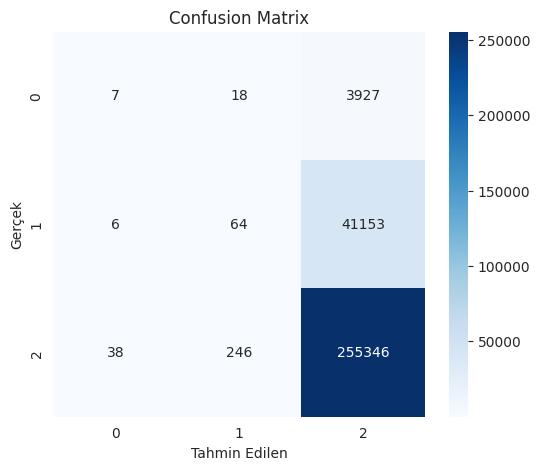

In [23]:
plt.figure(figsize=(6,5))
sns.heatmap(confusion_matrix(y_test, y_pred), annot=True, fmt='d', cmap='Blues')
plt.title('Confusion Matrix')
plt.xlabel('Tahmin Edilen')
plt.ylabel('Gerçek')
plt.show()